**Author:** Elias Rafael Ruiz-Morales

**Institution:** Wellcome Sanger institute

**July, 2023**

---

# Notebook to fine annotate cell compartments in the All-infections integrated data


In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import os
import sys
import anndata
import scvi


In [2]:
for folder in ['../results/images/integrated/','../results/images/integrated/annotationFine/']:
    if not os.path.exists(folder):
        os.makedirs(folder)
        #loop over the subfolders of the rawdata folder

In [3]:
def MovePlots(plotpattern, subplotdir):
    os.system('mkdir -p '+str(sc.settings.figdir)+'/'+subplotdir)
    os.system('mv '+str(sc.settings.figdir)+'/*'+plotpattern+'** '+str(sc.settings.figdir)+'/'+subplotdir)

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.figdir = '../results/images/integrated/annotationFine/'
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=200)  # low dpi (dots per inch) yields small inline figures

sys.executable

-----
anndata     0.7.5
scanpy      1.7.1
sinfo       0.3.1
-----
PIL                 8.1.2
absl                NA
anndata             0.7.5
anyio               NA
attr                20.3.0
babel               2.9.0
backcall            0.2.0
brotli              NA
cairo               1.20.0
certifi             2020.12.05
cffi                1.14.5
chardet             4.0.0
cloudpickle         1.6.0
colorama            0.4.4
cycler              0.10.0
cython_runtime      NA
cytoolz             0.11.0
dask                2021.03.1
dateutil            2.8.1
decorator           4.4.2
fsspec              0.8.7
get_version         2.1
google              NA
h5py                3.1.0
idna                2.10
igraph              0.8.3
ipykernel           5.5.0
ipython_genutils    0.2.0
ipywidgets          7.6.3
jedi                0.18.0
jinja2              2.11.3
joblib              1.0.1
json5               NA
jsonschema          3.2.0
jupyter_server      1.4.1
jupyterlab_server   2.3.0
kiw

'/opt/conda/bin/python'

In [4]:
def identityTransfer(adata_CellsNewID, adata, field='cell_type'):
    
    '''
    Function to transfer the value in a .obs column, modifying only the cells included in adata_CellsNewID
    
    Parameters:
        adata_CellsNewID: anndata object with cells. These should have in their .obs[field] the new values to be transfer to adata
        adata: anndata object to modify. The value in .obs[field] will be modifies for all the cells in adata_CellsNewID
        field: column name in .obs to operate in
        
    '''
    
    #converting categorical into strings to introduce new categories
    adata.obs[field]=adata.obs[field].astype("string")


    #assigning the new categories to the cells in adata
    for cell in adata_CellsNewID.obs.index:
        adata.obs[field][cell] = adata_CellsNewID.obs[field][cell]

    #Returning strings into categorical 
    adata.obs[field]=adata.obs[field].astype("category")
    
    return(adata)

In [5]:
sc.set_figure_params(figsize=(6,6))

## Loading data

In [6]:
adata= sc.read('../results/scVI/rna6_scVIintegrated_latent30_20230707.h5ad')

In [7]:
#Normalize and scale data to run neirest neighbors and plot gene expression
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

normalizing counts per cell
    finished (0:00:03)


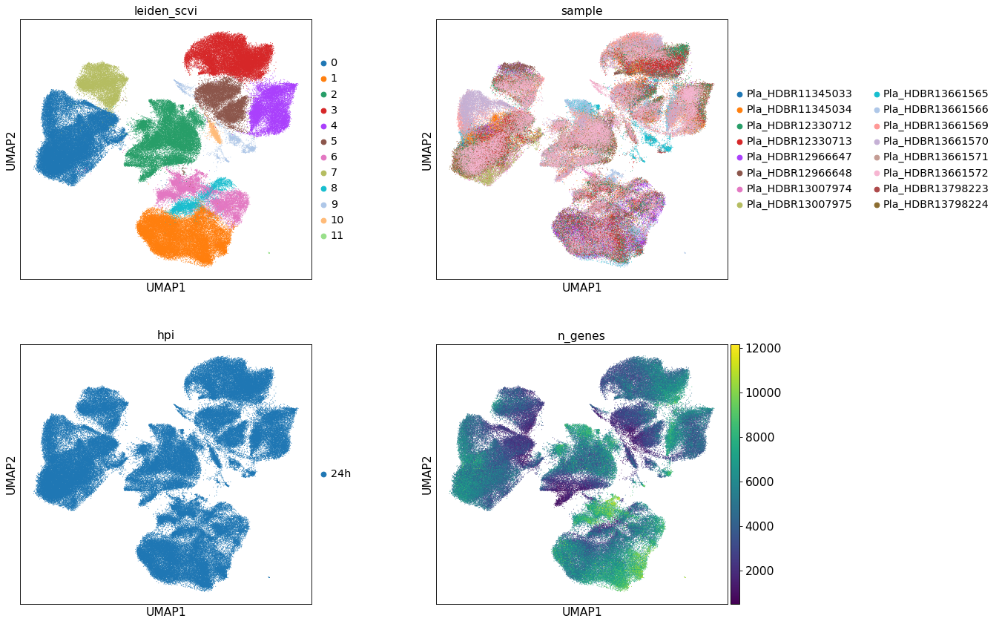

In [8]:
# use scVI imputed values for plotting
sc.pl.umap(adata, color=["leiden_scvi",'sample',#'donor_souporcell', 
                         'hpi','n_genes' ]
           ,ncols=2, size=3, wspace=0.3, save='_scVI_latent30.pdf')

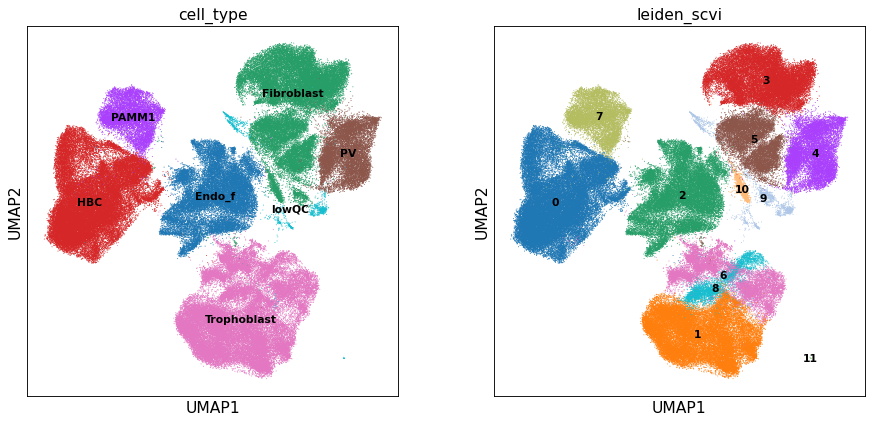

In [9]:
sc.pl.umap(adata, color=['cell_type', 'leiden_scvi'], size=3, legend_loc='on data',legend_fontsize='x-small')

In [10]:
adata.obs['cell_type_broad']=adata.obs['cell_type']

#  log regression- label transfering predictions

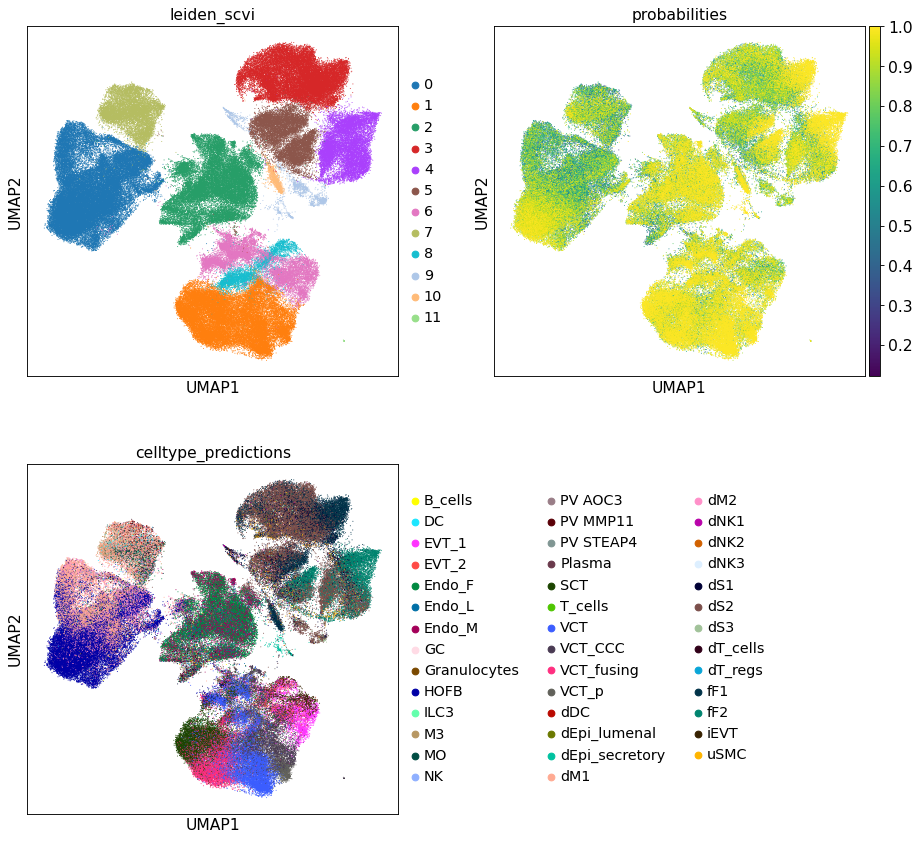

In [11]:
# use scVI imputed values for plotting
sc.pl.umap(adata, color=[ 'leiden_scvi', 'probabilities','celltype_predictions'], ncols=2,
           save='_scVI_latent30_labTransfering.pdf', size=3)

# Fine annotation

### Erythrocytes

TFRC (CD71) is the differentiation gene between mature erythrocytes (CD71-) and inmature ones, reticulocytes, (CD71+)
 https://doi.org/10.1016/j.bcmd.2018.06.004


RUVBL1, CD55 , and CD36 should also be express in reticulocytes but not in erythrocytes.



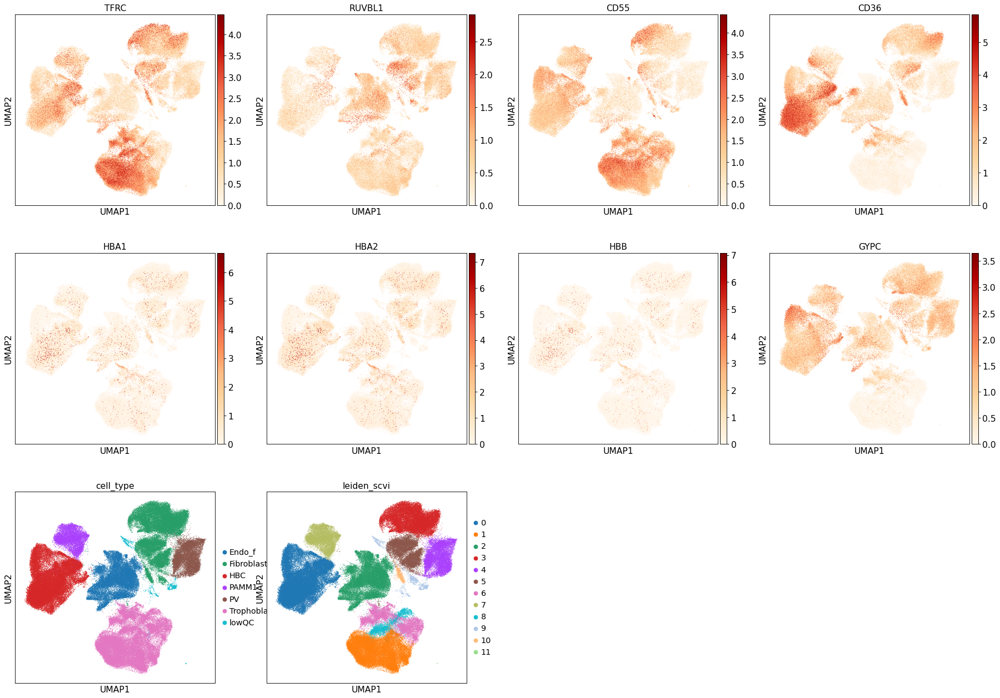

In [12]:
sc.pl.umap(adata, color=['TFRC','RUVBL1','CD55','CD36', "HBA1",'HBA2','HBB',"GYPC", 'cell_type','leiden_scvi'],color_map='OrRd',
           save='_scVI_latent30_erythrocyteMarkers.pdf', size=3)

In [13]:
adata.write('../results/scVI/rna6_scVIintegrated_latent30_CleanV1_20230707.h5ad')

## -- dS --

In [14]:
#temp_cells = adata[adata.obs['identity'] == 'dS']

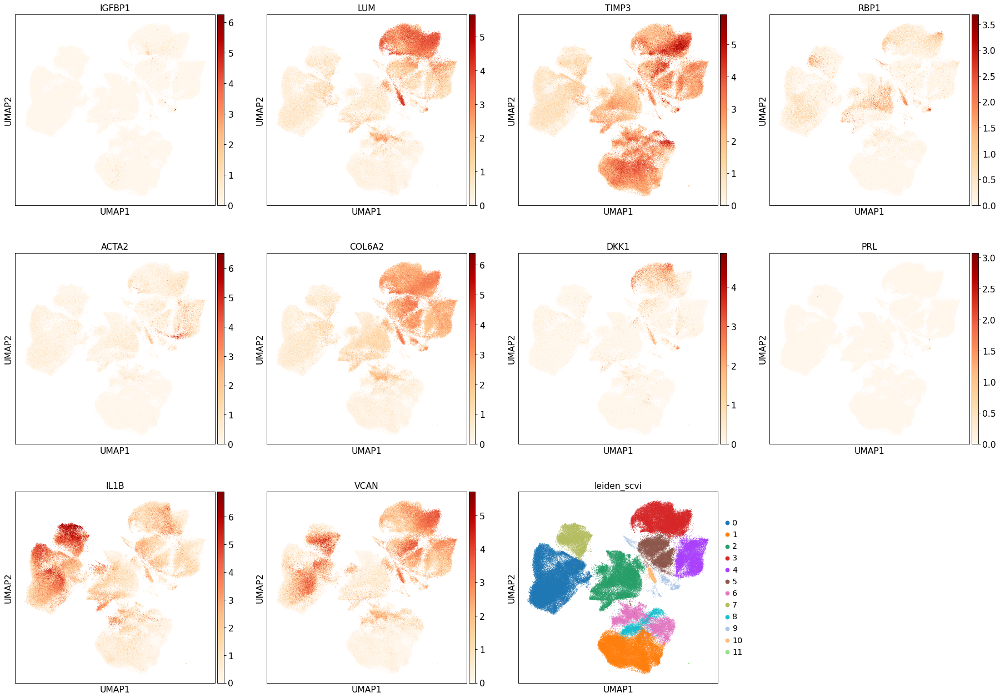

In [14]:
#These are dS markers, to help me to differentiate between the 3 sub-populations

# ACTA2 is higher in dS1
# RBP1,TIMP3 and LUM higher in dS2

sc.pl.umap(adata, color=['IGFBP1', 'LUM','TIMP3','RBP1', 'ACTA2', 'COL6A2', 'DKK1',
                         'PRL','IL1B', 'VCAN','leiden_scvi'],color_map='OrRd', size=3)

The left part expresses fibroblast markers as DLK1 but not the dS marker IGFBP1. Those are fibroblasts

##### Re-doing the analysis to get enough resolution inside the dS

## -- Endo --

In [15]:
sc.set_figure_params(figsize=(4,4))

In [16]:
temp_cells = adata[adata.obs['cell_type'] == 'Endo_f']

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [17]:
# Run PCA
#sc.tl.pca(temp_cells)

#LATENT 30
sc.pp.neighbors(temp_cells, n_neighbors=25, use_rep="X_scVI_n_latent_20")
sc.tl.umap(temp_cells)

#clustering
sc.tl.leiden(temp_cells, key_added="leiden_scvi", resolution=0.6)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:31)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:10)
running Leiden clustering
    finished: found 11 clusters and added
    'leiden_scvi', the cluster labels (adata.obs, categorical) (0:00:04)


In [18]:

#clustering
sc.tl.leiden(temp_cells, key_added="leiden_scvi", resolution=0.7)

running Leiden clustering
    finished: found 11 clusters and added
    'leiden_scvi', the cluster labels (adata.obs, categorical) (0:00:06)


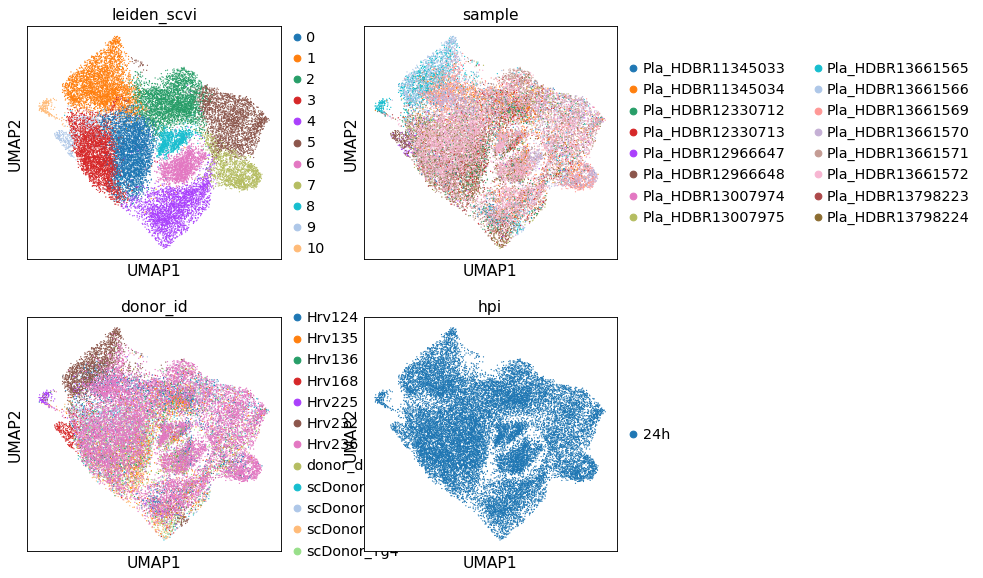

In [19]:
#clustering
sc.pl.umap(temp_cells, color=["leiden_scvi",'sample','donor_id', 'hpi'],ncols=2, size=5)

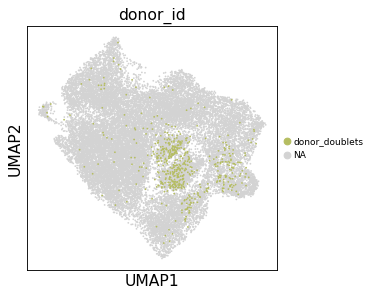

In [20]:
sc.pl.umap(temp_cells, color=['donor_id' ], legend_fontsize='xx-small', size=10, ncols=2, groups=['donor_doublets'] )

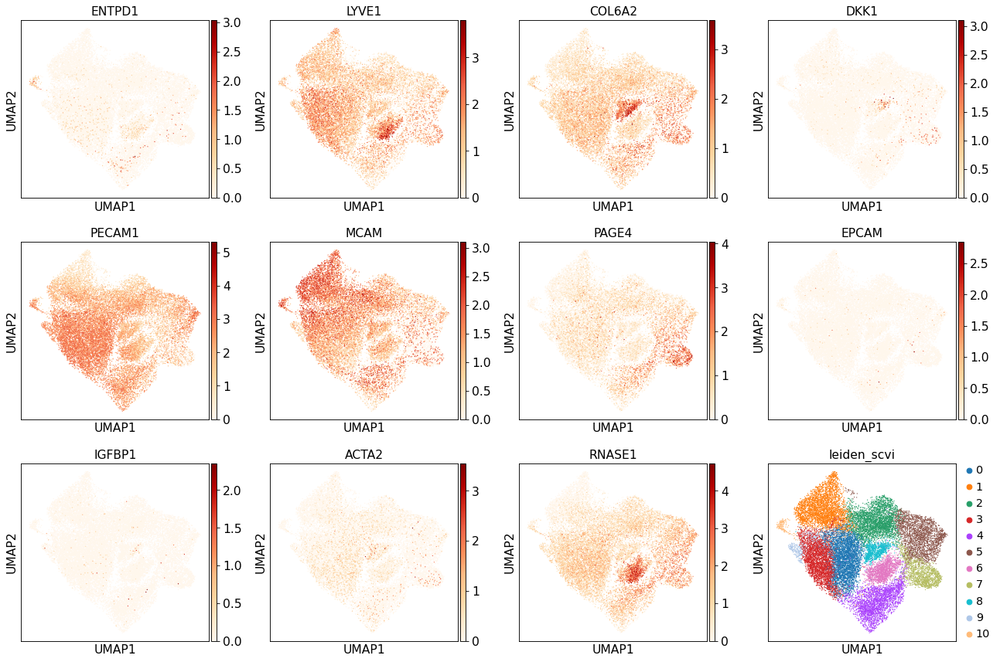

In [21]:
sc.pl.umap(temp_cells, color=[ 'ENTPD1', 'LYVE1', 'COL6A2', 'DKK1','PECAM1','MCAM',
                         'PAGE4','EPCAM', 'IGFBP1', 'ACTA2','RNASE1',
                         'leiden_scvi'],color_map='OrRd', size=5)

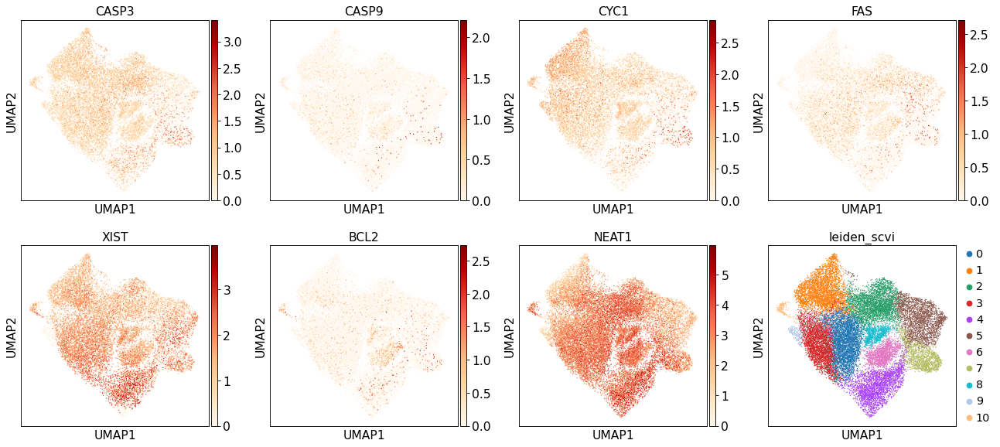

In [22]:
sc.pl.umap(temp_cells, color=[ 'CASP3', 'CASP9', 'CYC1','FAS','XIST','BCL2','NEAT1', 
                         'leiden_scvi'],color_map='OrRd', size=5)

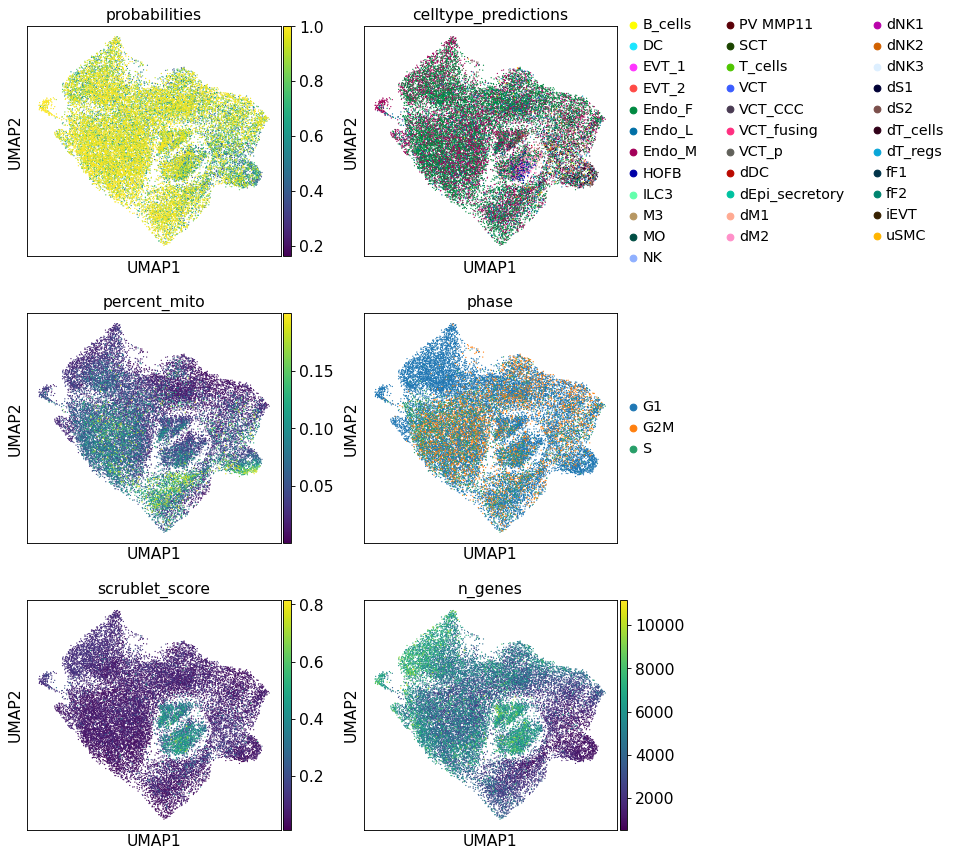

In [23]:
sc.pl.umap(temp_cells, color=['probabilities',"celltype_predictions", 'percent_mito','phase','scrublet_score','n_genes'],
           ncols=2, size=5)

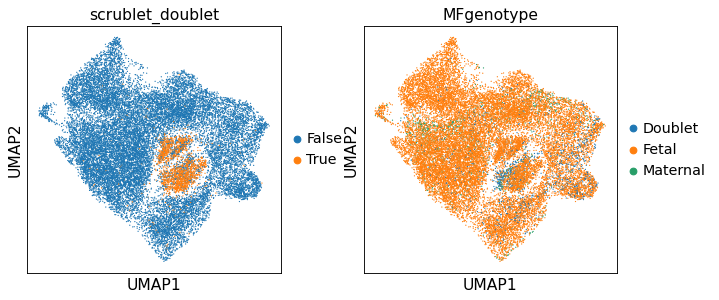

In [24]:
sc.pl.umap(temp_cells, color=['scrublet_doublet','MFgenotype' ],
           ncols=2, size=5)

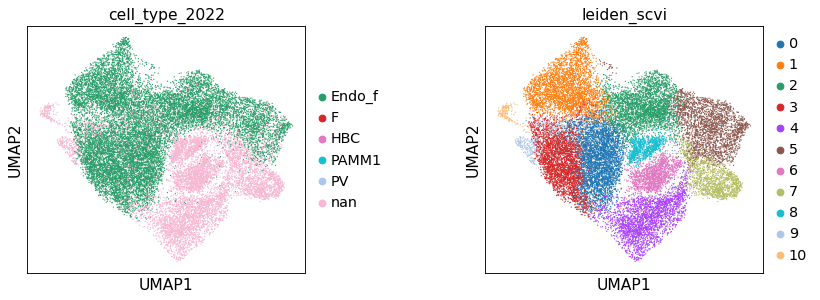

In [27]:
sc.pl.umap(temp_cells, color=['cell_type_2022','leiden_scvi'],
           ncols=2, size=5, wspace=0.5)

In [28]:
#COpying the value of the leiden cluster. The new column will help to change it's values for
# the cluster identity
temp_cells.obs['cell_type']= temp_cells.obs['leiden_scvi']


#Function that changes the cluster names as indicated
temp_cells.obs['cell_type'] = (temp_cells.obs["leiden_scvi"].map(lambda x: 
                            {"0": "Endo_f", "1": "Endo_f", "2": "Endo_f", "3": "Endo_f",
                            "4": "Endo_f", "5": "Endo_f", "6": "doublets",
                            "7": "lowQC", "8": "doublets", "9": "lowQC", "10": "lowQC"}
                            .get(x, x)).astype("category"))

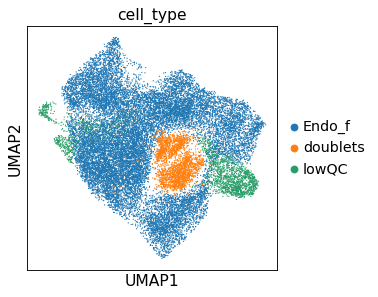

In [29]:
#clustering
sc.pl.umap(temp_cells, color=["cell_type"],ncols=2, size=5)

In [30]:
adata= identityTransfer(temp_cells, adata)

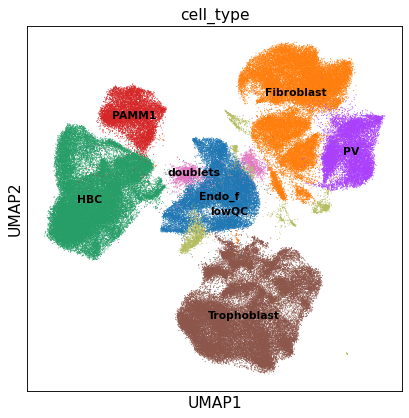

In [31]:
sc.set_figure_params(figsize=(6,6))

# use scVI imputed values for plottin
sc.pl.umap(adata, color=['cell_type' ], legend_loc='on data',legend_fontsize='x-small', size=3)

## --- Fibroblasts ---  

Rescuing few cells annotated as HFF but that weren't from the Tg_pure samples

In [32]:
#Selecting the cells in the desired clusters
temp_cells =adata[[ i in ['Fibroblast','PV'] for i in adata.obs.cell_type ]]

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [33]:
#LATENT 30
sc.pp.neighbors(temp_cells, n_neighbors=25, use_rep="X_scVI_n_latent_30")
sc.tl.umap(temp_cells)

#clustering
sc.tl.leiden(temp_cells, key_added="leiden_scvi", resolution=0.4)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:11)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:27)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden_scvi', the cluster labels (adata.obs, categorical) (0:00:15)


In [34]:
temp_cells

AnnData object with n_obs × n_vars = 46817 × 36601
    obs: 'sample', 'stage', 'hpi', 'infection', 'percent_mito', 'n_counts', 'batch', 'sample_barcode', 'assignment_SoC', 'donor_id', 'scrublet_score', 'scrublet_cluster_score', 'zscore', 'bh_pval', 'bonf_pval', 'is_doublet', 'infection_stage', 'S_score', 'G2M_score', 'phase', 'n_genes_by_counts', 'total_counts', 'total_counts_hs', 'pct_counts_hs', 'total_counts_tg', 'pct_counts_tg', 'Tg_infected', 'n_genes', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden_scvi', 'celltype_predictions', 'probabilities', 'scrublet_doublet', 'cell_type_2022', 'cell_type', 'souporcell_MFgenotype', 'MFgenotype', 'cell_type_broad'
    var: 'gene_ids', 'feature_types', 'mean-0', 'std-0', 'mean-1', 'std-1', 'mean-2', 'std-2', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'MFgenotype_colors', '_scvi', 'cell_type_2022_colors', 'cell_type_colors', 'celltype_predictions_colors', 'donor_

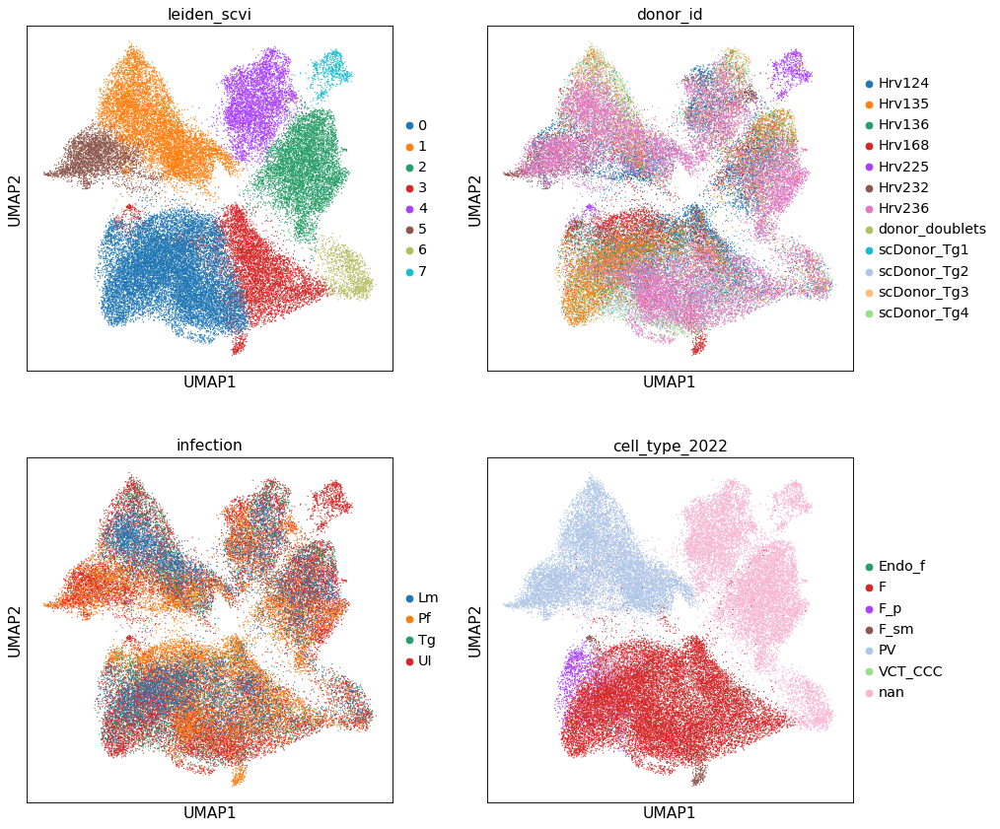

In [36]:
#clustering
sc.pl.umap(temp_cells, color=["leiden_scvi",'donor_id','infection','cell_type_2022'],ncols=2, size=5)

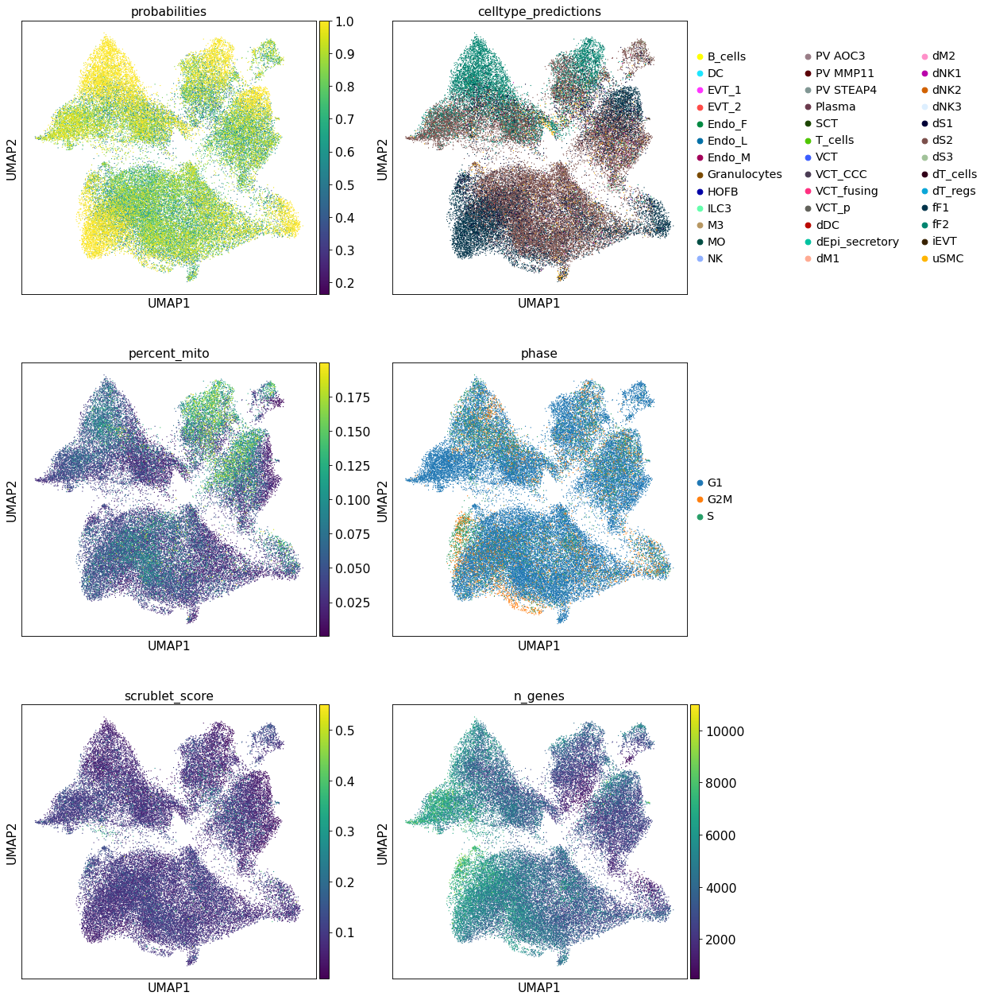

In [37]:
sc.pl.umap(temp_cells, color=['probabilities',"celltype_predictions", 'percent_mito','phase','scrublet_score','n_genes'],
           ncols=2, size=5)

#### Fibroblasts differential markers

F1: DKK1, SERPINE2


F2: PDGFRB, AGTR1

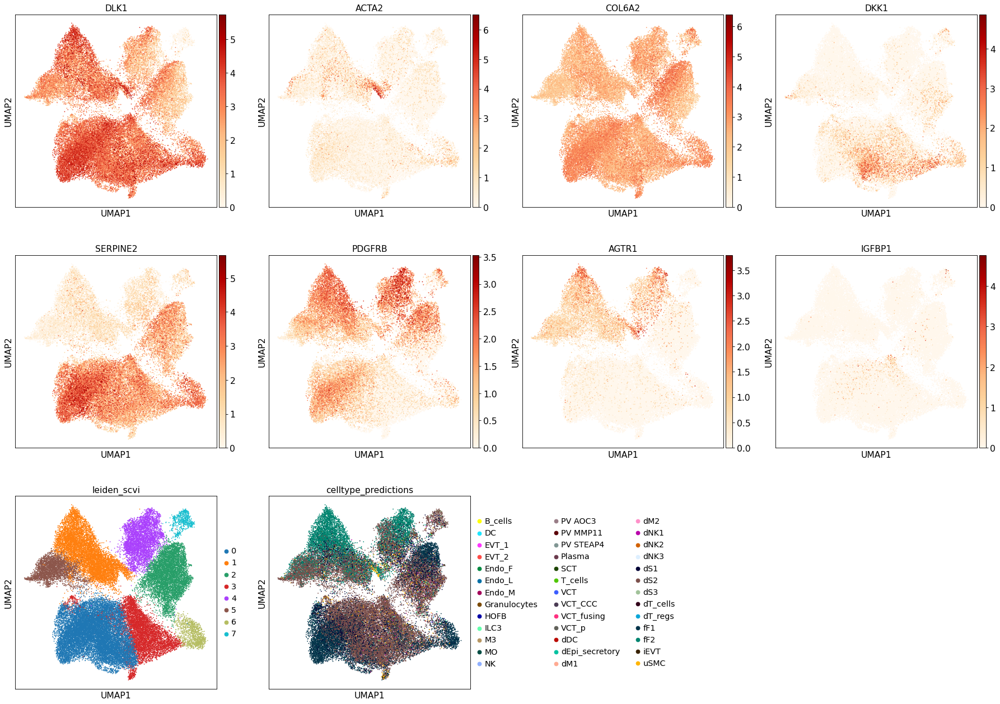

In [38]:
sc.pl.umap(temp_cells, color=['DLK1', 'ACTA2', 'COL6A2',
                              'DKK1','SERPINE2', #F1
                              'PDGFRB','AGTR1', #F2/PV
                              'IGFBP1', #dS
                         'leiden_scvi',"celltype_predictions" ],color_map='OrRd', size=10)

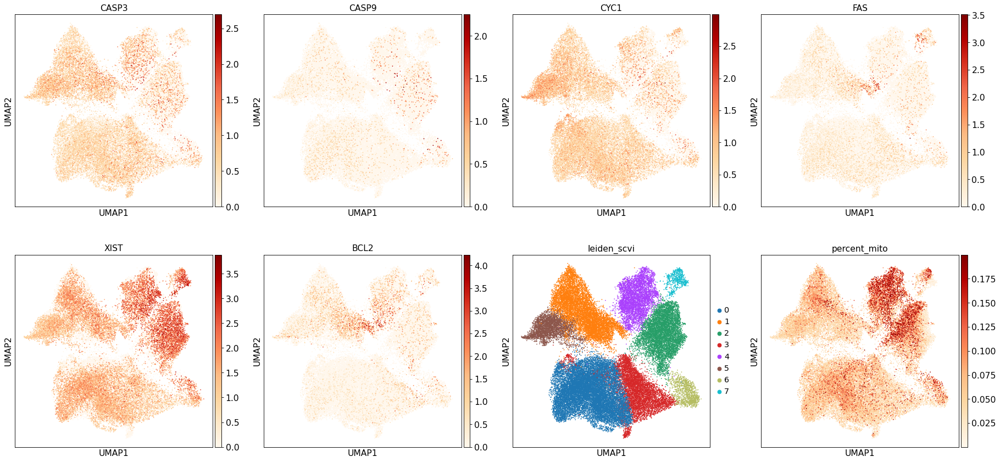

In [39]:
sc.pl.umap(temp_cells, color=['CASP3', 'CASP9', 'CYC1','FAS','XIST','BCL2', 'leiden_scvi', 'percent_mito'],
           color_map='OrRd', size=10)

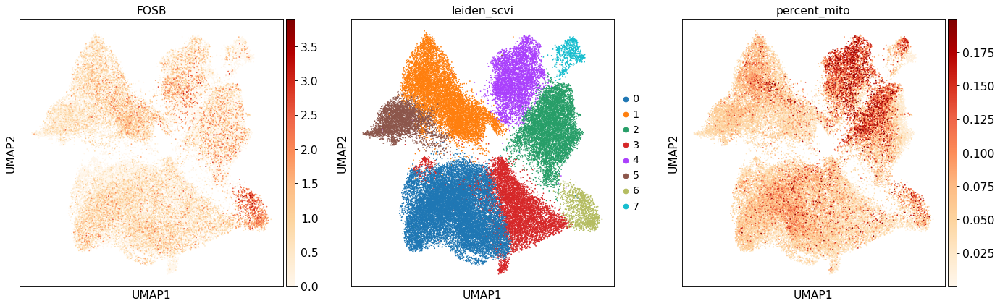

In [40]:
sc.pl.umap(temp_cells, color=['FOSB', 'leiden_scvi', 'percent_mito'],
           color_map='OrRd', size=10)

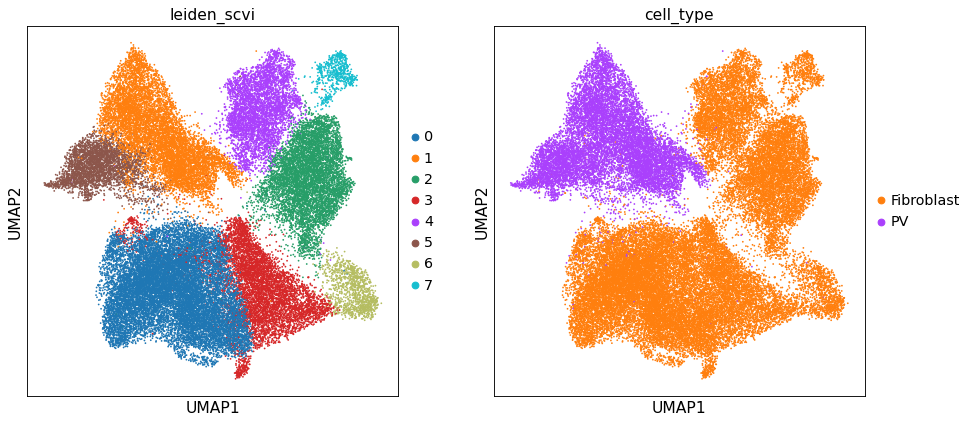

In [41]:
sc.pl.umap(temp_cells, color=[ 'leiden_scvi','cell_type'],
           color_map='OrRd', size=10)

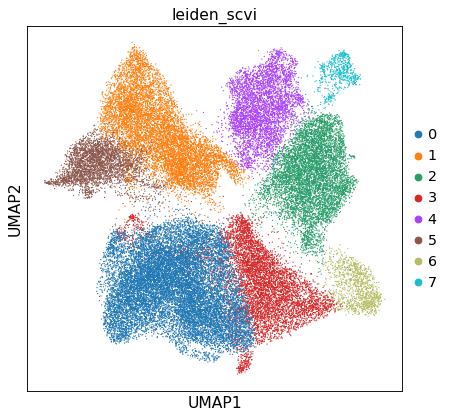

In [42]:
#clustering
sc.pl.umap(temp_cells, color=["leiden_scvi"],ncols=2, size=5)

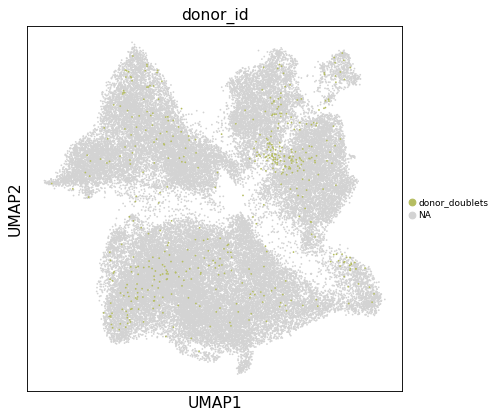

In [43]:
sc.pl.umap(temp_cells, color=['donor_id' ], legend_fontsize='xx-small', size=10, ncols=2, groups=['donor_doublets'] )

In [44]:
#COpying the value of the leiden cluster. The new column will help to change it's values for
# the cluster identity
temp_cells.obs['cell_type']= temp_cells.obs['leiden_scvi']


#Function that changes the cluster names as indicated
temp_cells.obs['cell_type'] = (temp_cells.obs["leiden_scvi"].map(lambda x: 
                            {"0": "F", "1": "PV", "2": "lowQC", "3": "F", "4": "lowQC",
                            "5": "PV","6": "lowQC","7": "lowQC"}
                            .get(x, x)).astype("category"))

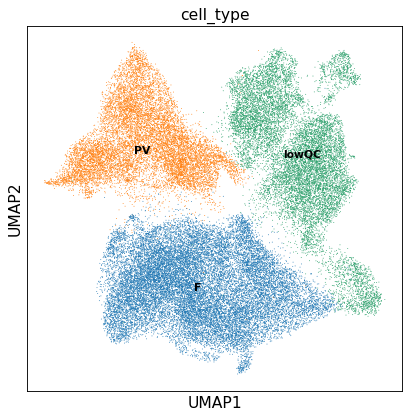

In [45]:
# use scVI imputed values for plottin
sc.pl.umap(temp_cells, color=['cell_type' ], legend_loc='on data',legend_fontsize='x-small')

In [46]:
adata= identityTransfer(temp_cells, adata)

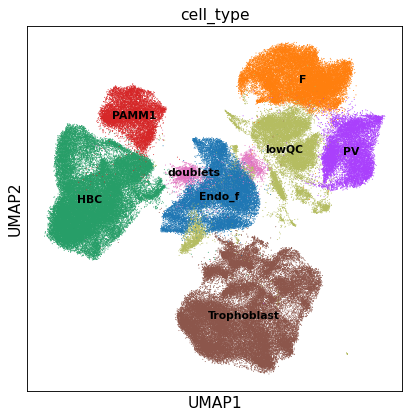

In [47]:
# use scVI imputed values for plotting
sc.pl.umap(adata, color=['cell_type' ], legend_loc='on data',legend_fontsize='x-small', size=3)

computing density on 'umap'
--> added
    'umap_density_Tg_infected', densities (adata.obs)
    'umap_density_Tg_infected_params', parameter (adata.uns)
/opt/conda/lib/python3.8/site-packages/scanpy/plotting/_tools/__init__.py:1182: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  color_map.set_over('black')
/opt/conda/lib/python3.8/site-packages/scanpy/plotting/_tools/__init__.py:1183: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  color_map.set_under('lightgray')
/opt/conda/lib/python3.8/site-packages/scanpy/

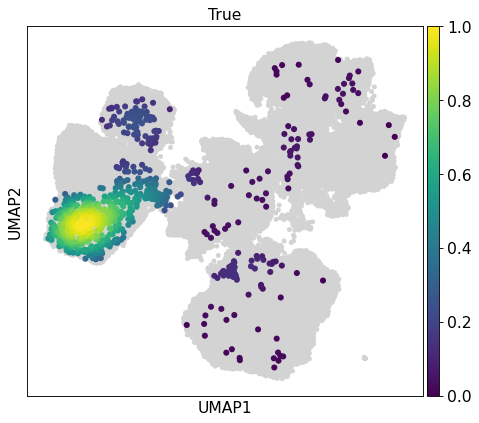

In [48]:
sc.tl.embedding_density(adata, basis='umap', groupby='Tg_infected')

sc.pl.embedding_density(adata, basis='umap', key='umap_density_Tg_infected',group=['True'],
                        fg_dotsize=120, color_map='viridis')

In [49]:
adata.write('../results/scVI/rna6_scVIintegrated_latent30_CleanV1_20230707.h5ad')

In [50]:
#adata= sc.read('../results/exp_infection/scVI/exp7_scVIintegrated_latent30_CleanV1_20220828.h5ad')

## -- Throphoblasts --

In [51]:
temp_cells = adata[adata.obs['cell_type'] == 'Trophoblast']

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [52]:
#LATENT 30
sc.pp.neighbors(temp_cells, n_neighbors=20, use_rep="X_scVI_n_latent_30")
sc.tl.umap(temp_cells)

#clustering
sc.tl.leiden(temp_cells, key_added="leiden_scvi", resolution=0.4)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:09)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:22)
running Leiden clustering
    finished: found 7 clusters and added
    'leiden_scvi', the cluster labels (adata.obs, categorical) (0:00:08)


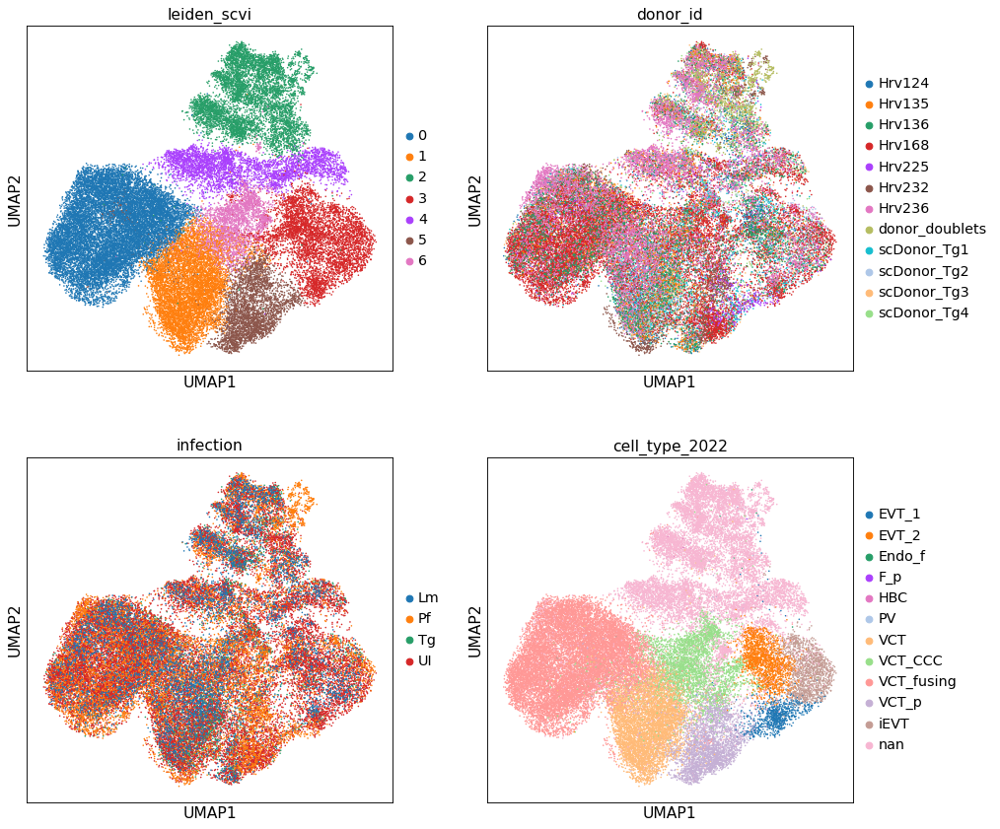

In [54]:

#clustering
sc.pl.umap(temp_cells, color=["leiden_scvi",'donor_id','infection','cell_type_2022'],ncols=2, size=8)

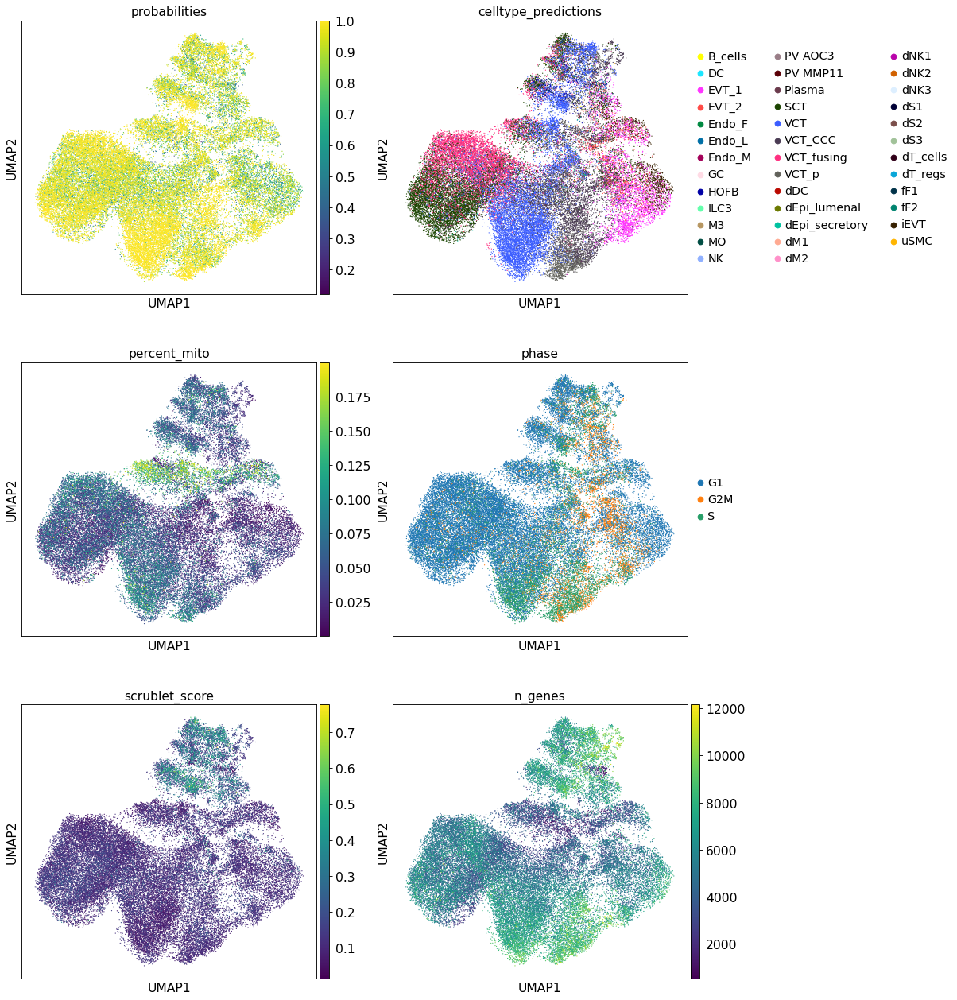

In [55]:
sc.pl.umap(temp_cells, color=['probabilities',"celltype_predictions", 'percent_mito','phase','scrublet_score','n_genes'],
           ncols=2, size=5)

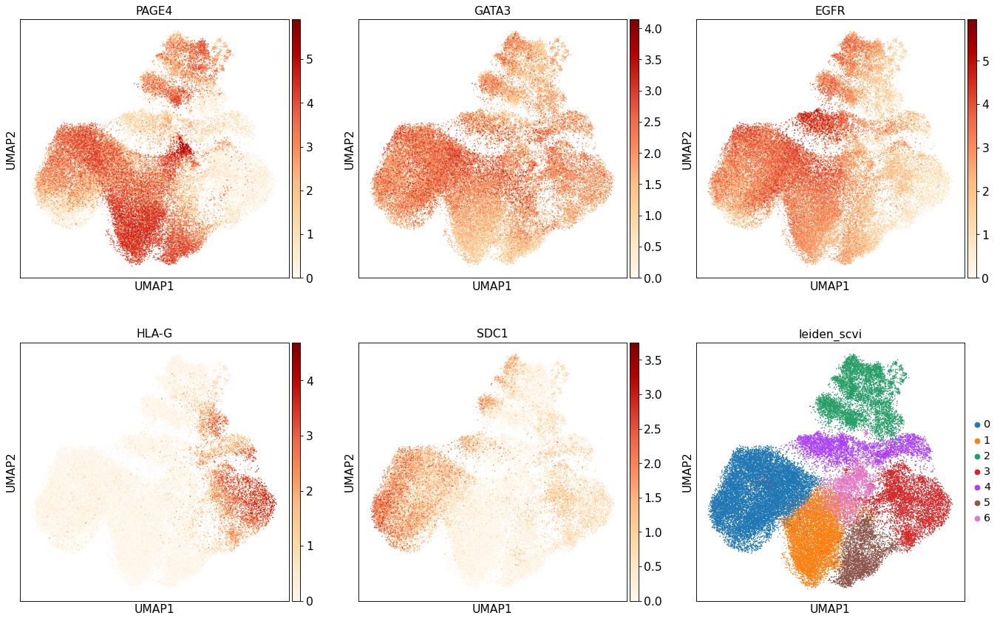

In [56]:
sc.pl.umap(temp_cells, color=['PAGE4', 'GATA3', 'EGFR', 'HLA-G','SDC1','leiden_scvi']
           ,color_map='OrRd',size=8, ncols=3)

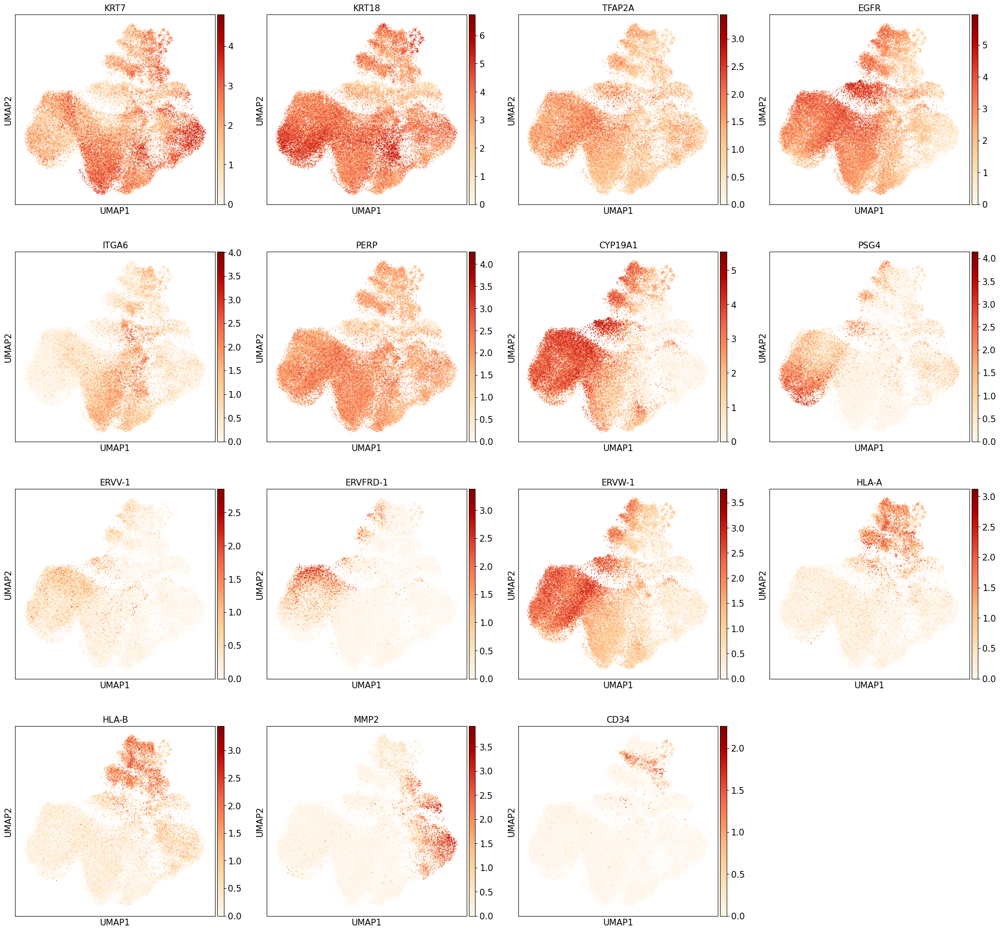

In [57]:
sc.pl.umap(temp_cells, color=['KRT7','KRT18', 'TFAP2A', 'EGFR' ,'ITGA6','PERP', #Trophoblast
                         'CYP19A1','PSG4', #SCT
                         'ERVV-1', #VCT
                         'ERVFRD-1', 'ERVW-1', #SCT & VCT
                         'HLA-A','HLA-B', # NO trophoblast
                         'MMP2', #dS
                         'CD34'#Endo
                             ], use_raw=False, size=8,color_map='OrRd', save='_otherMarkers_scVI_latent30.pdf')

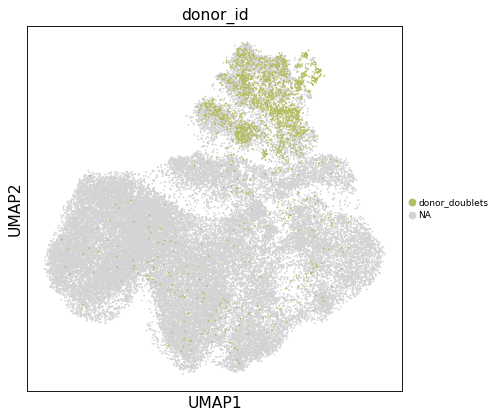

In [58]:
sc.pl.umap(temp_cells, color=['donor_id' ], legend_fontsize='xx-small', size=10, ncols=2, groups=['donor_doublets'] )

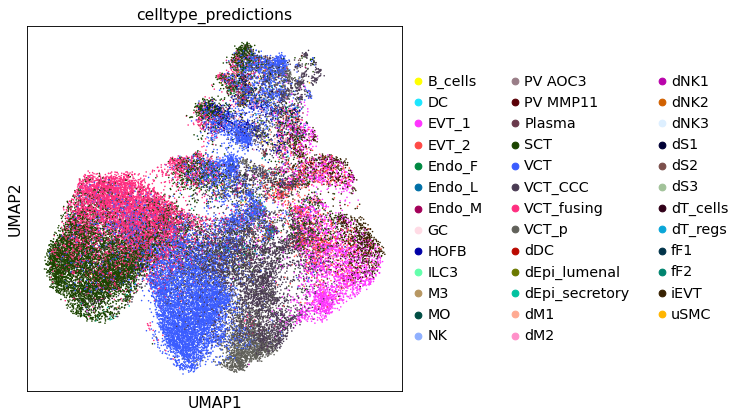

In [59]:
sc.pl.umap(temp_cells, color=["celltype_predictions"],
           ncols=2, size=8)

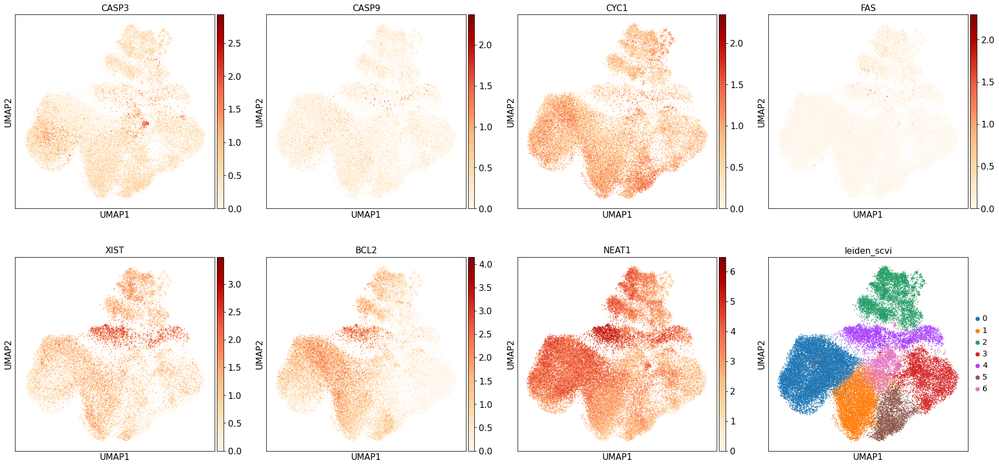

In [60]:
sc.pl.umap(temp_cells, color=['CASP3', 'CASP9', 'CYC1','FAS','XIST','BCL2','NEAT1', 'leiden_scvi'],
           color_map='OrRd', size=8)

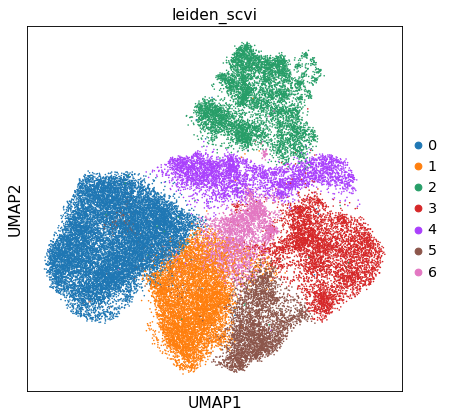

In [61]:
sc.pl.umap(temp_cells, color=[ 'leiden_scvi'],
           color_map='OrRd', size=8)

In [62]:
#COpying the value of the leiden cluster. The new column will help to change it's values for
# the cluster identity
temp_cells.obs['cell_type']= temp_cells.obs['leiden_scvi']


#Function that changes the cluster names as indicated
temp_cells.obs['cell_type'] = (temp_cells.obs["leiden_scvi"].map(lambda x: 
                            {"0": "VCT", "1": "VCT", "2": "doublets", "3": "EVT", "4": "lowQC",
                             "5": "VCT","6": "VCT"}
                            .get(x, x)).astype("category"))

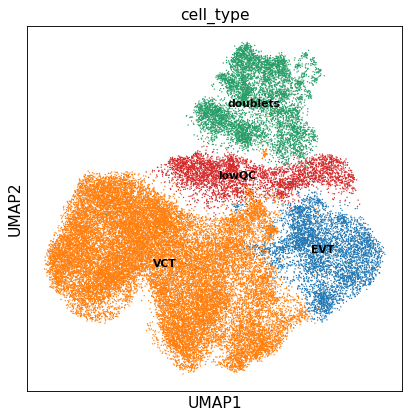

In [63]:
# use scVI imputed values for plottin
sc.pl.umap(temp_cells, color=['cell_type' ], legend_loc='on data',legend_fontsize='x-small', size=6)

In [64]:
adata= identityTransfer(temp_cells, adata)

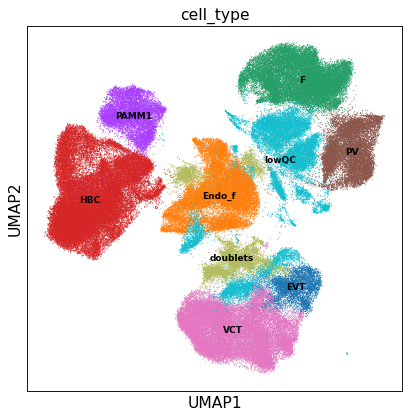

In [65]:
# use scVI imputed values for plottin
sc.pl.umap(adata, color=['cell_type' ], legend_loc='on data',legend_fontsize='xx-small', size=3)

In [66]:
adata.write('../results/scVI/rna6_scVIintegrated_latent30_CleanV1_20230707.h5ad')

## -- Macrophages --

In [67]:
#Selecting the cells in the desired clusters
temp_cells =adata[[ i in ['HBC','PAMM1'] for i in adata.obs.cell_type ]]

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [68]:
#LATENT 30
sc.pp.neighbors(temp_cells, n_neighbors=25, use_rep="X_scVI_n_latent_30")
sc.tl.umap(temp_cells)

#clustering
sc.tl.leiden(temp_cells, key_added="leiden_scvi", resolution=0.7)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:11)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:30)
running Leiden clustering
    finished: found 11 clusters and added
    'leiden_scvi', the cluster labels (adata.obs, categorical) (0:00:18)


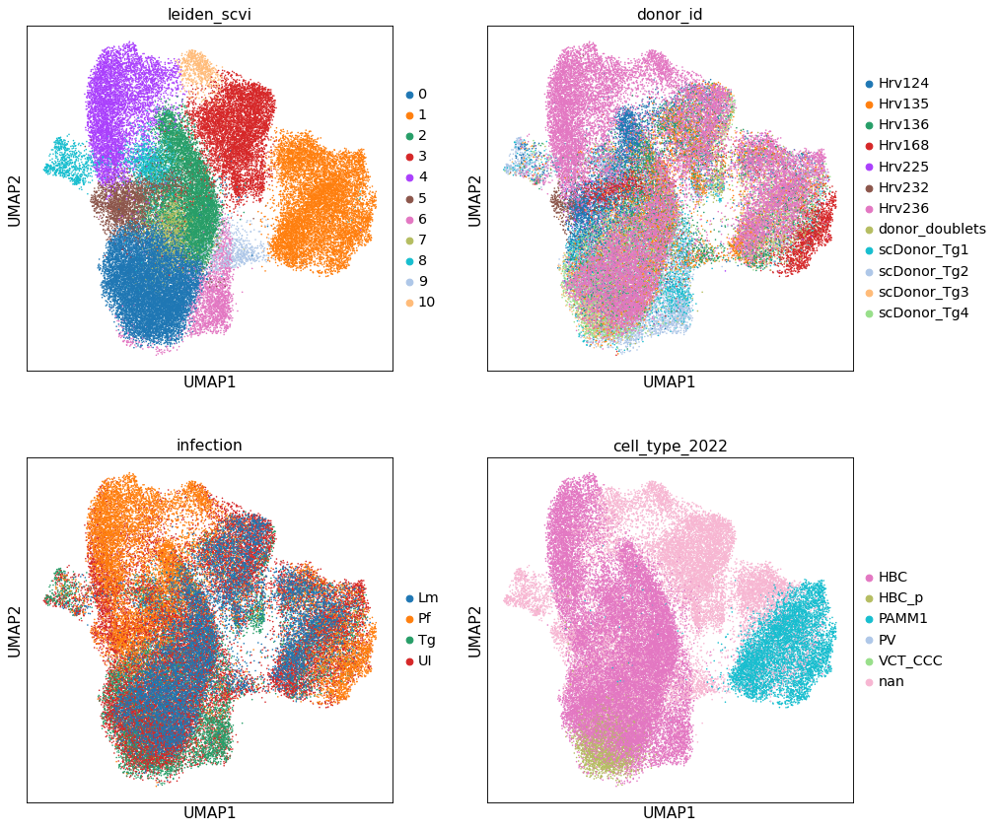

In [70]:

#clustering
sc.pl.umap(temp_cells, color=["leiden_scvi",'donor_id','infection','cell_type_2022'],ncols=2,  size=8)

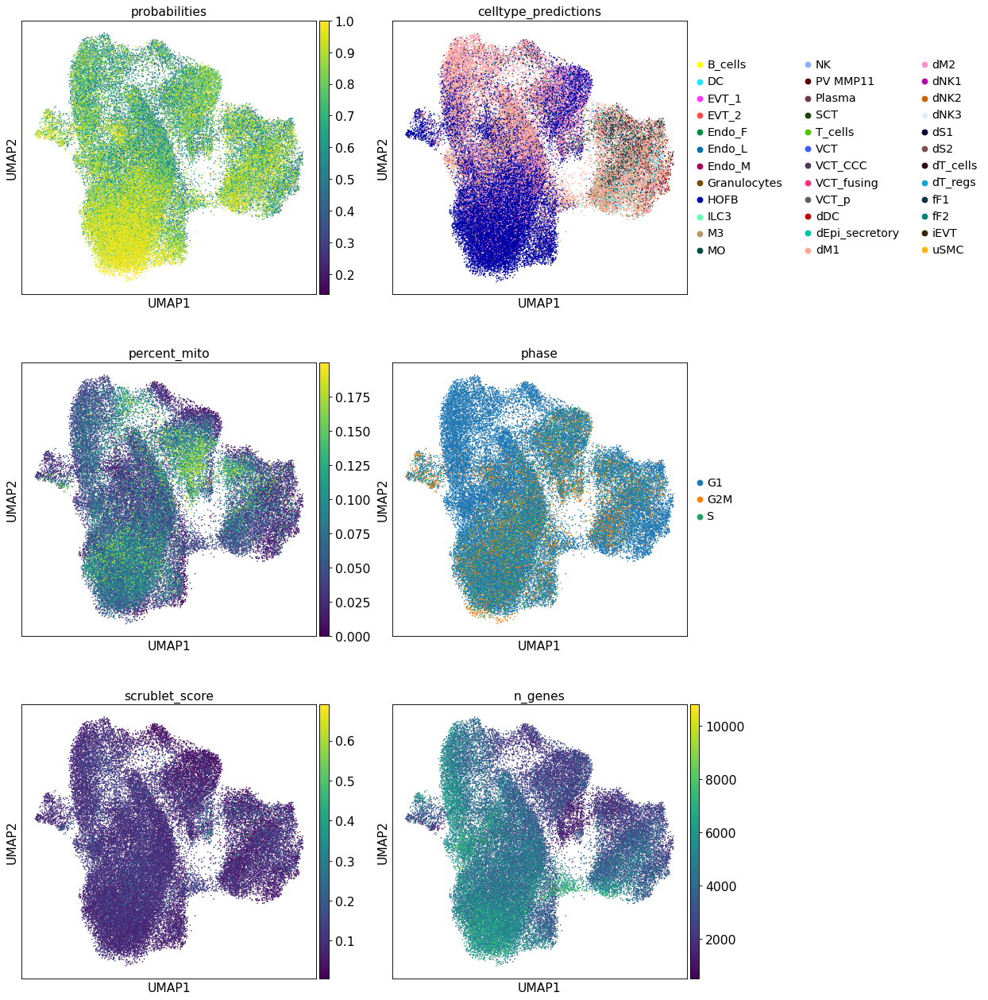

In [71]:
sc.pl.umap(temp_cells, color=['probabilities',"celltype_predictions", 'percent_mito','phase','scrublet_score','n_genes'],
           ncols=2, size=8)

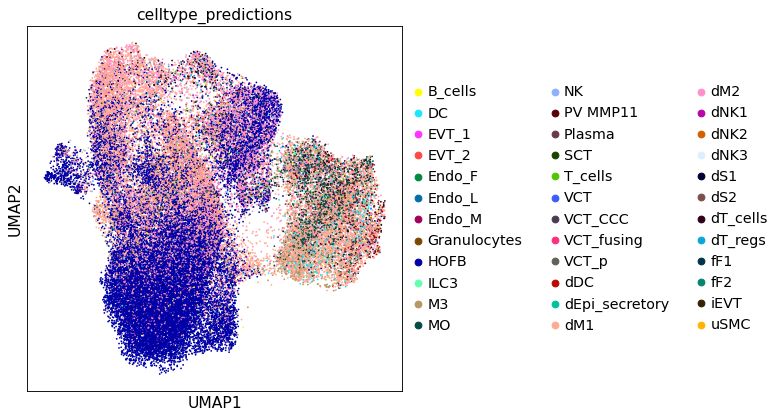

In [72]:
sc.pl.umap(temp_cells, color=["celltype_predictions"], size=10)

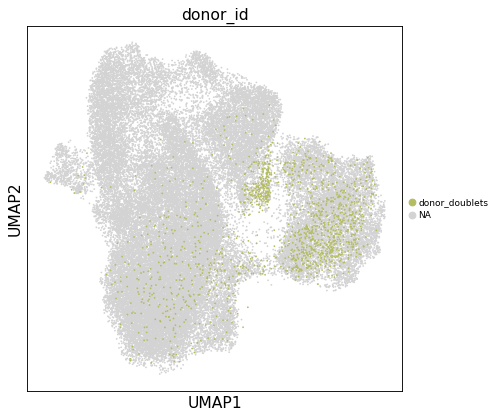

In [73]:
sc.pl.umap(temp_cells, color=['donor_id' ], legend_fontsize='xx-small', size=10, ncols=2, groups=['donor_doublets'] )

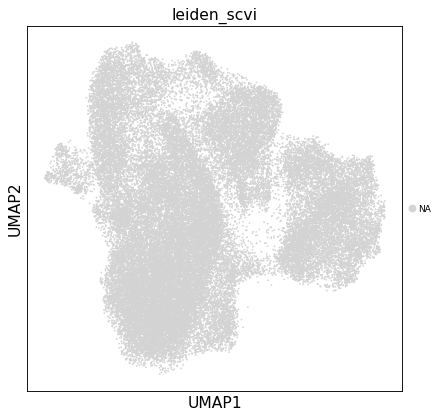

In [74]:
sc.pl.umap(temp_cells, color=['leiden_scvi' ], legend_fontsize='xx-small', size=10, ncols=2, groups=['11'] )

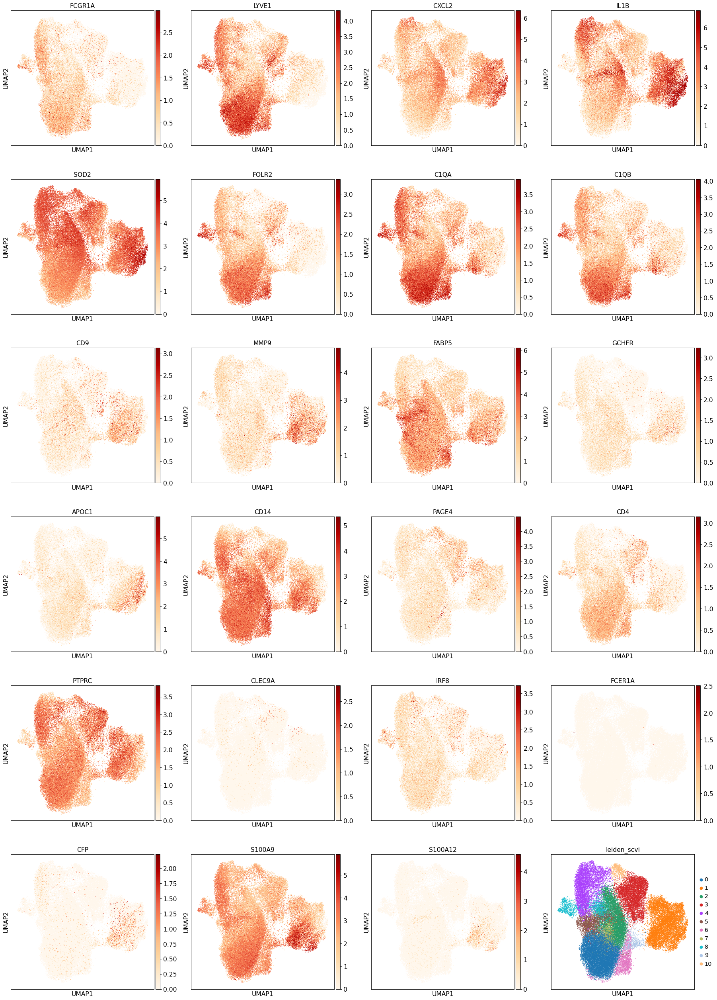

In [75]:
#dM1: CXCL2, IL1B, SOD2
#dM2: C1QB,C1QA, SEPP1, FOLR2, IL1B neg
#dM3: APOC1, CD9, GCHFR
sc.pl.umap(temp_cells, color=['FCGR1A','LYVE1', #HB
                              'CXCL2', 'IL1B', 'SOD2', #dM1
                              'FOLR2', #HB & dM2
                              'C1QA','C1QB',#dM2
                              'CD9', 'MMP9','FABP5','GCHFR','APOC1',#M3
                              'CD14',
                              'PAGE4','CD4','PTPRC',
                              'CLEC9A','IRF8', #DC1
                              'FCER1A','CFP',#DC2
                              'S100A9','S100A12',#Mo
                              'leiden_scvi'],color_map='OrRd', size=9)



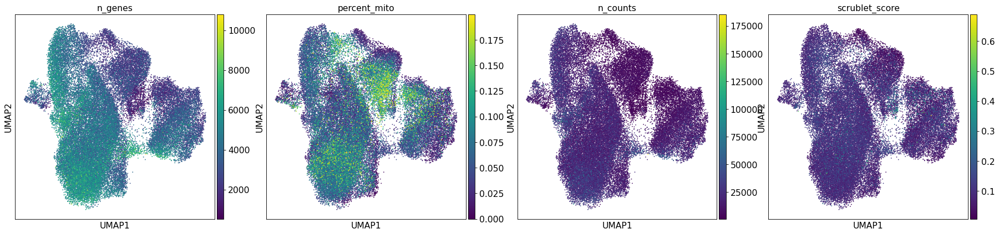

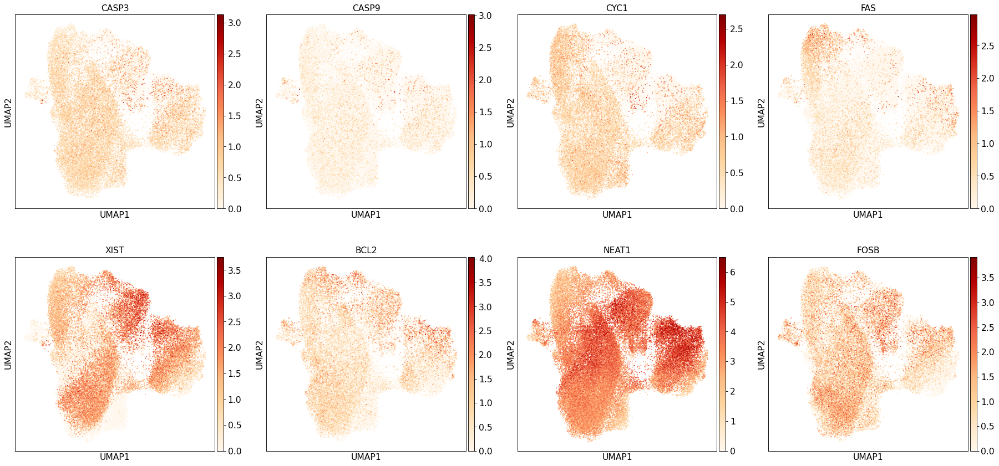

In [76]:
sc.pl.umap(temp_cells, color=[  "n_genes",'percent_mito','n_counts','scrublet_score'], size=10)

sc.pl.umap(temp_cells, color=['CASP3', 'CASP9', 'CYC1','FAS','XIST','BCL2','NEAT1', 'FOSB'],
           color_map='OrRd', size=10)
                         

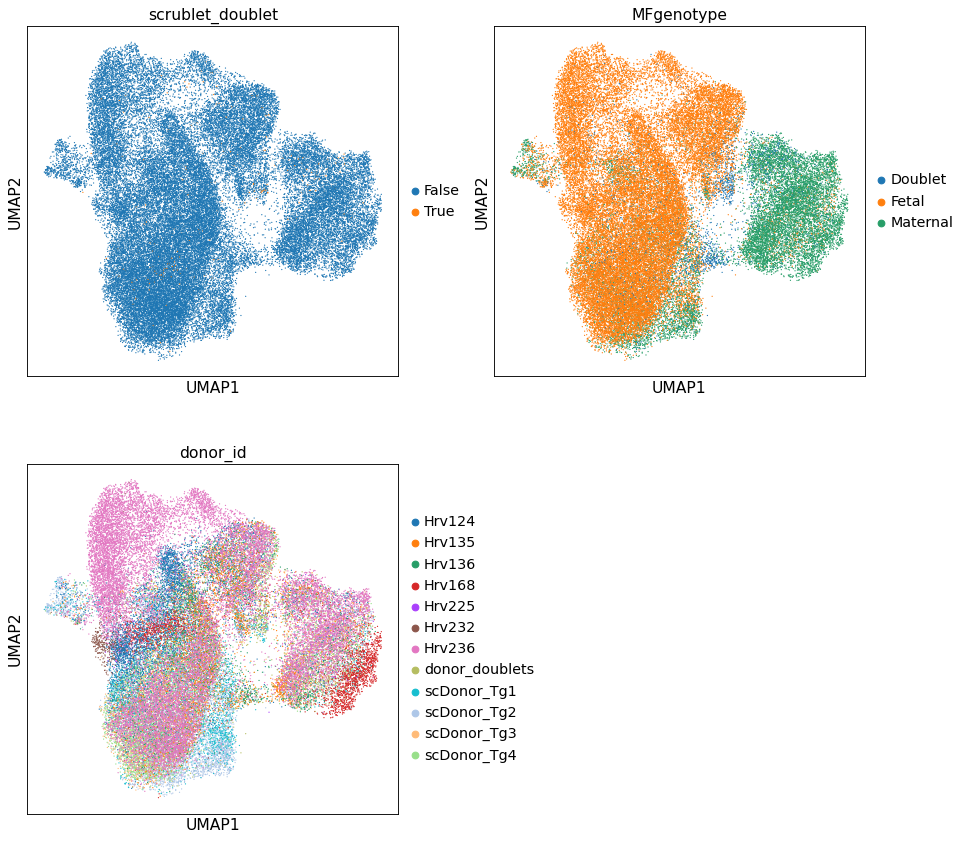

In [77]:
sc.pl.umap(temp_cells, color=['scrublet_doublet','MFgenotype', 'donor_id' ],
           ncols=2, size=5)


In [78]:
#COpying the value of the leiden cluster. The new column will help to change it's values for
# the cluster identity
temp_cells.obs['cell_type']= temp_cells.obs['leiden_scvi']


#Function that changes the cluster names as indicated
temp_cells.obs['cell_type'] = (temp_cells.obs["leiden_scvi"].map(lambda x: 
                            {"0": "HBC", "1": "PAMM1", "2": "HBC", "3": "lowQC", "4": "HBC","5": "HBC",
                             "6": "HBC","7": "HBC","8": "lowQC","9": "doublets","10": "lowQC"}
                            .get(x, x)).astype("category"))

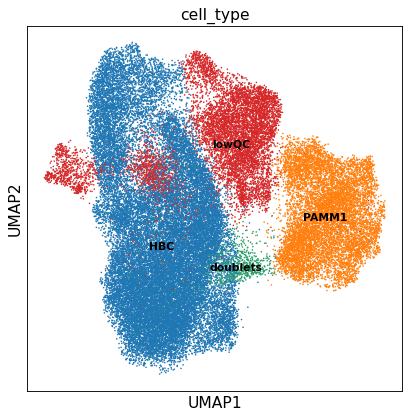

In [79]:
# use scVI imputed values for plottin
sc.pl.umap(temp_cells, color=['cell_type' ], legend_loc='on data',legend_fontsize='x-small', size=8)

In [80]:
adata= identityTransfer(temp_cells, adata)

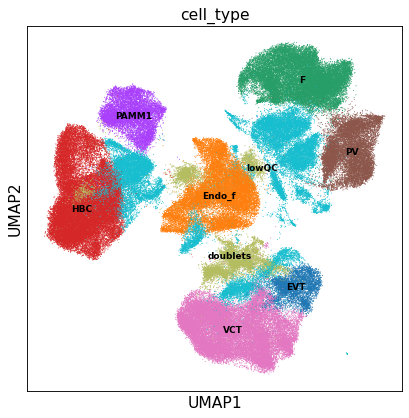

In [81]:
# use scVI imputed values for plottin
sc.pl.umap(adata, color=['cell_type' ],legend_fontsize='xx-small',legend_loc='on data',size=3)

In [82]:
adata.write('../results/scVI/rna6_scVIintegrated_latent30_CleanV1_20230707.h5ad')

### Removing clusters of apoptotic / lowQC cells and doublets

In [83]:
adata = adata[adata.obs['cell_type'] != 'lowQC']
adata = adata[adata.obs['cell_type'] != 'doublets']

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [84]:
#LATENT 30
sc.pp.neighbors(adata, n_neighbors=20, use_rep="X_scVI_n_latent_30")
sc.tl.umap(adata)

#clustering
sc.tl.leiden(adata, key_added="leiden_scvi", resolution=0.3)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:27)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:27)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden_scvi', the cluster labels (adata.obs, categorical) (0:00:26)


In [85]:
sc.set_figure_params(figsize=(6,6))

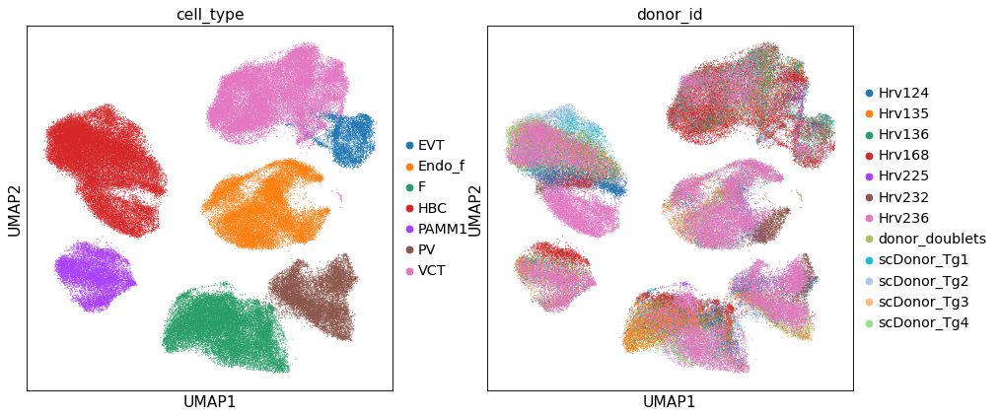

In [86]:
sc.pl.umap(adata, color=['cell_type', 'donor_id'],
           color_map='OrRd', ncols=2, size=3)

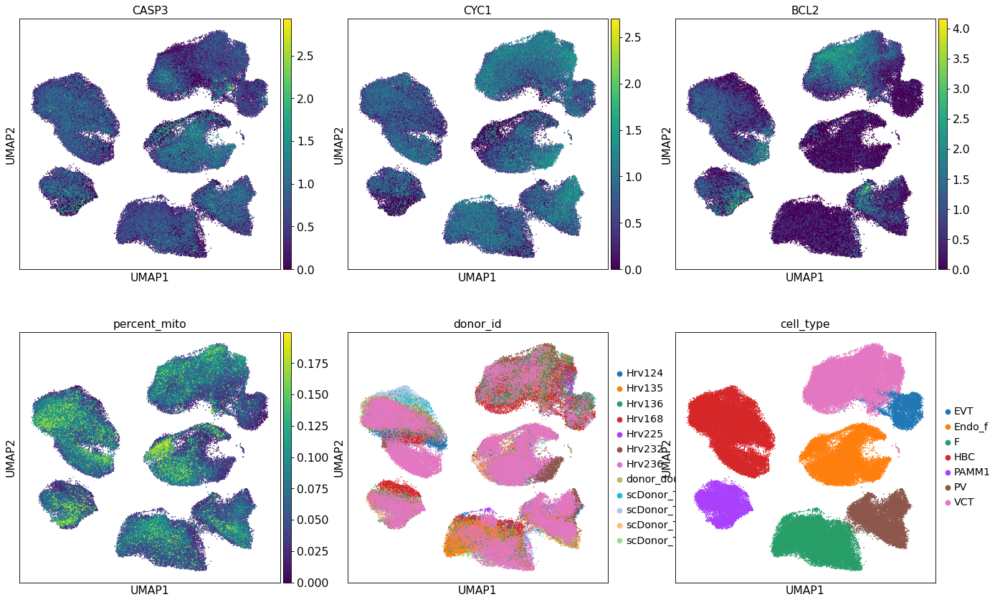

In [87]:
sc.pl.umap(adata, color=['CASP3','CYC1','BCL2',"percent_mito", 'donor_id','cell_type'],
            ncols=3, size=8, save='_scVI_latent30_cleanV2_apoptoticGenes.pdf',)

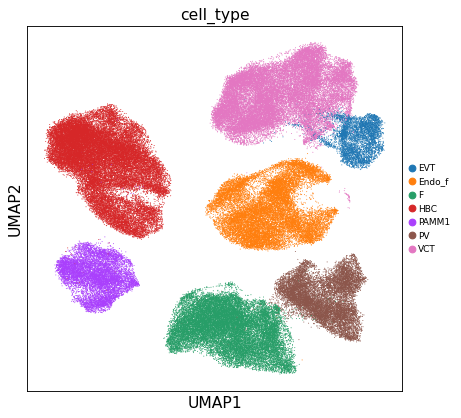

In [88]:
# use scVI imputed values for plottin
sc.pl.umap(adata, color=['cell_type' ],legend_fontsize='xx-small', size=3,
           save='_scVI_latent30_cleanV2.pdf', )

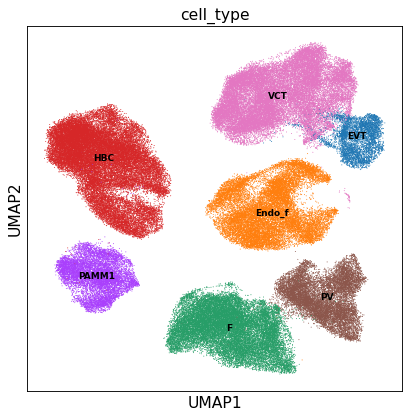

In [89]:
# use scVI imputed values for plottin
sc.pl.umap(adata, color=['cell_type' ],legend_fontsize='xx-small',legend_loc= 'on data', size=3,
           save='_scVI_latent30_cleanV2_ondata.pdf')

In [90]:
adata.X=adata.layers['raw_counts'].copy()

In [91]:
adata.write('../results/scVI/rna6_scVIintegrated_latent30_CleanV2_20230707.h5ad')

In [92]:
adata.X.shape

(125235, 36601)

# Saving Trophoblasts in a single object


In [93]:
#Selecting the cells in the desired clusters
temp_cells = adata[adata.obs['cell_type'] == 'EVT']
temp_cells2= adata[adata.obs['cell_type'] == 'VCT']

Trophoblasts = temp_cells.concatenate(temp_cells2, index_unique=None)

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [94]:
del(temp_cells, temp_cells2)

... storing 'leiden_scvi' as categorical
... storing 'celltype_predictions' as categorical
... storing 'cell_type' as categorical


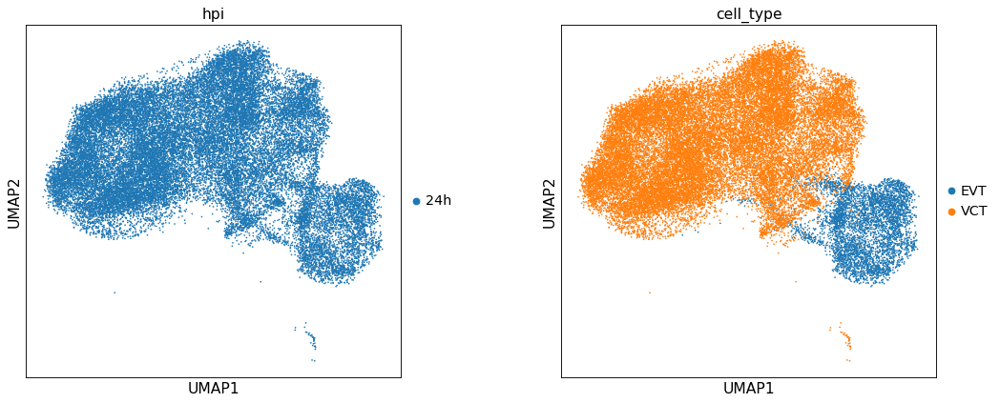

In [95]:
sc.pl.umap(Trophoblasts, color=['hpi', 'cell_type'], color_map='OrRd',wspace=0.3, size=9)

In [96]:
#LATENT 30
sc.pp.neighbors(Trophoblasts, n_neighbors=15, use_rep="X_scVI_n_latent_30")
sc.tl.umap(Trophoblasts)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:12)


running Leiden clustering
    finished: found 10 clusters and added
    'leiden_scvi', the cluster labels (adata.obs, categorical) (0:00:08)


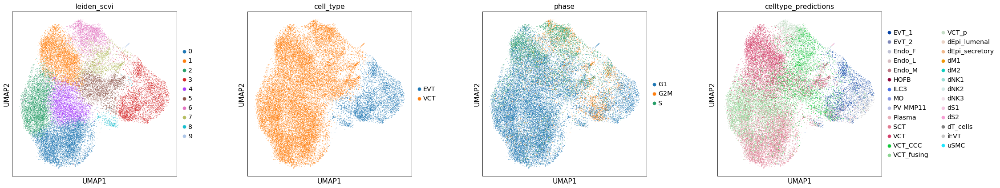

In [97]:
#clustering
sc.tl.leiden(Trophoblasts, key_added="leiden_scvi", resolution=0.6)


sc.pl.umap(Trophoblasts, color=["leiden_scvi",'cell_type','phase','celltype_predictions'],wspace=0.3,)

In [98]:
#Saving the modified object
Trophoblasts.write('../results/scVI/rna6_scVIintegrated_latent30_Trophoblasts_20230707.h5ad')

In [99]:
Trophoblasts

AnnData object with n_obs × n_vars = 32818 × 36601
    obs: 'sample', 'stage', 'hpi', 'infection', 'percent_mito', 'n_counts', 'batch', 'sample_barcode', 'assignment_SoC', 'donor_id', 'scrublet_score', 'scrublet_cluster_score', 'zscore', 'bh_pval', 'bonf_pval', 'is_doublet', 'infection_stage', 'S_score', 'G2M_score', 'phase', 'n_genes_by_counts', 'total_counts', 'total_counts_hs', 'pct_counts_hs', 'total_counts_tg', 'pct_counts_tg', 'Tg_infected', 'n_genes', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden_scvi', 'celltype_predictions', 'probabilities', 'scrublet_doublet', 'cell_type_2022', 'cell_type', 'souporcell_MFgenotype', 'MFgenotype', 'cell_type_broad', 'umap_density_Tg_infected'
    var: 'gene_ids', 'feature_types', 'mean-2', 'std-2', 'highly_variable', 'means', 'variances', 'variances_norm', 'mean-0', 'std-0', 'highly_variable_rank-0', 'mean-1', 'std-1', 'highly_variable_rank-1'
    uns: 'hpi_colors', 'cell_type_colors', 'neighbors', 'umap', 'l